# Projection juxtaposer

<img src="http://reconstrue.com/projects/brightfield_neurons/allen_morphology_viz.png" width="500px" />

This tool's primary purposes is to juxtapose two images of the same dimensions both, for the same `cell_id`:
1. The MinIP image
2. A rendering of the projection of SWC to 2D  

In this document, the shorthand "MinIP" stands in for the Minimum Intensity Projection, a 2D mugshot of a 3D stack of slide images. In the case of MinIP images downloaded from the Allen Institute's brain-map.org, the MinIP files are JPEG 2000 compressed, seemingly. The MinIPs are normally a few thousand pixels on a side. The image file will normally be less than 100 megabyte in size.

The SWC file (named `*.swc` un-mnemonically) describes a 3D skeleton of a neuron. The SWC file format is tabular and textual, similar to a CSV file. Turns out the core task here is to render a 2D image of the SWC.


## Motivation

The two images can be juxtaposed and examined to see how accurate the reconstructed skeletons looks when overlaid on the MinIP. More importantly, the second image, the SWC projection, can also be used as a training mask to a 2D image segmentor ML model trained to recognize neurons in MinIPs.

A 2D mask is useful unto its own; not just 3D is useful. Besides being useful unto its own, 2D is good place to start attacking the problem, because the testing will be cheaper and faster. Once 2D error rates are dropping then start exploring 3D with confidence, low res at first again for data volume concerns.

Finally, this same 2D image of 3D SWC will be used to generate small training masks of dimensions (256,256,1) or maybe (512,512,1).

## Workflow

The main workflow is:
1. [User selects a `cell_id`](#scrollTo=mXQ8OOzrSzjm) 
2. Two files are downloaded from the Allen:
  - The MinIP image 
  - The corresponding `*.swc` file
3. SWC's skeleton 3D model rendered as 2D B&W image
4. The two images are displayed juxtaposed/overlaid

The MinIP file can be requested of the Allen Institute's repository, [the Cell Types Database](http://reconstrue.com/data_sources/allen_institute/cell_types_db.html), as can the corresponding SWC file. The SWC is a tabluar textual file, similar to a CSV file. 

The main task here is #3: to take the SWC text file and generate a 2D image file containing a pixelated rendering of the 3D skeleton projected to 2D, in binary "B&W" not even grayscale.

This notebook has been tested to work on Google's Colab and vanilla JupyterLab.

## Setup


### Installations

The Allen Institute maintains the Allen SDK, `allensdk`, for accessing their data products. Colab has tons of Python packages pre-installed but `allensdk` is not one of them. For more details about working with `allensdk` on Colab, see Reconstrue's [AllenSDK on Colab](http://reconstrue.com/data_sources/allen_institute/allensdk_on_colab.html). For now, simply install the SDK.

Note: 2020-04-12, ERRORs for distributed and allensdk. Can be safely ignored?

In [2]:
!pip3 --quiet install tornado datashader allensdk

     |████████████████████████████████| 15.5MB 307kB/s 
     |████████████████████████████████| 1.5MB 44.7MB/s 
     |████████████████████████████████| 71kB 7.9MB/s 
     |████████████████████████████████| 81kB 10.0MB/s 
     |████████████████████████████████| 1.6MB 45.6MB/s 
     |████████████████████████████████| 92kB 9.9MB/s 
     |████████████████████████████████| 3.4MB 46.5MB/s 
     |████████████████████████████████| 61kB 8.2MB/s 
     |████████████████████████████████| 2.9MB 48.7MB/s 
     |████████████████████████████████| 102kB 10.5MB/s 
     |████████████████████████████████| 71kB 8.4MB/s 
     |████████████████████████████████| 4.3MB 41.5MB/s 
     |████████████████████████████████| 1.2MB 44.7MB/s 
     |████████████████████████████████| 42.5MB 99kB/s 
     |████████████████████████████████| 51kB 6.8MB/s 
     |████████████████████████████████| 81kB 10.4MB/s 
     |████████████████████████████████| 7.4MB 46.3MB/s 
     |████████████████████████████████| 614kB 46.2MB/s 
     

In [3]:
# otherwise: AttributeError: module 'shapely' has no attribute 'geometry'
!pip3 -q install spatialpandas

     |████████████████████████████████| 61kB 2.0MB/s 
     |████████████████████████████████| 63.2MB 68kB/s 


In [4]:
!apt install ffmpeg

Reading package lists... Done
Building dependency tree       
Reading state information... Done
ffmpeg is already the newest version (7:3.4.6-0ubuntu0.18.04.1).
0 upgraded, 0 newly installed, 0 to remove and 25 not upgraded.


### Imports

In [0]:
import imghdr
import json
import pandas as pd
import matplotlib.pyplot as plt
import requests
import seaborn as sns
import skimage.io
import urllib.parse
import PIL

from IPython.display import display


In [0]:
# From another reconstrue notebook
import boto3
import datetime
import glob
import google
import ipywidgets
import json
import math
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import plotly
import time
import requests
import seaborn as sns
import skimage
import sys
import urllib
import IPython
import PIL

from IPython.display import HTML, display
from PIL import Image
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import minmax_scale

# TODO: just import google.colab; kill off other from google.colab's: 
# from google.colab import output
from google.colab import widgets
from google.colab import files
import plotly.graph_objects as go # TODO: lame alias, confusing






import datashader as ds
import datashader.transfer_functions as tf
import datashader.utils
import itertools
import shapely
from spatialpandas.geometry import PolygonArray
from spatialpandas import GeoDataFrame
from google.colab.data_table import DataTable



In [0]:
minips_collection_url = "http://api.brain-map.org/api/v2/section_image_download/"

As of late 2019, Colab "has a Data Table extension that allows interactive exploration of pandas dataframes with filtering and sorting." [[*](https://colab.research.google.com/notebooks/data_table.ipynb)]


In [0]:
#TODO: kill? %load_ext google.colab.data_table


In [0]:
from allensdk.core.cell_types_cache import CellTypesCache

# set up Allen Institute cache machinery
ctc = CellTypesCache(manifest_file='cell_types/manifest.json')



## Download data

Get MinIP and SWC files from brain-map.org.

Would be nice to have this code packaged into a utily class which [tf.data](https://www.tensorflow.org/tutorials/load_data/images#load_using_tfdata) can use to request two bits of data for a given ID. For a given `cell_id` check with `allensdk` that the ID is valid and that there is both a MinIP image file and a SWC file available for that cell_id. If so, then download and return both. Each pair is a training example and its labels, or 

(After that, from there some other TFX pipeline code will actually turn that into TFRecords, TFDatasets, protobufs, etc. Each neuron is actually good for a few hundred small examples, say, 256x256 or 512x512, which is the size many pre-trained models have been trained on…)

### Select cell_id to process

`cell_id` is the ID of the cell that will be used as the cell to fetch date for in all downloading in the rest of this notebook. The dropdown was manually populated 2020-04-14.



In [0]:
# 623185845 is the highest number ID, so most recent?
cell_id = 485909730 #@param [623185845, 614777438, 614767057, 609435731, 607124114, 485909730, 313862022] {type:"raw"}


Note: setting cell_id is done down here because quicker for re-runs. Just pick another `cell_id` and then click `Runtime->Run After` bypassing re-installs and set-up costs).

### Download MinIP

#### The MinIP needs to be fetched first, before the SWC

The SWC does not contain explicit information about the dimensions of the volume its skeleton was derived from. The coordinates in both the volume (and 2D projections there of, claro) and the skeleton are co-registered (read: they line up). Nonetheless, the `*.swc` does not define the maximum X, Y, nor Z. So, download the MinIP first, to get the X and Y.




In [0]:
def is_minip_in_archive(cell_id):
  return False # TODO:

def test_is_minip_in_archive():
  assert False == False
  # TODO:
  # query for cell w/ minip
  # query for cell w/o minip


In [0]:
from io import BytesIO

def get_minip_id(cell_id):
  minip_id = 0

  json_file_name = "/content/response.json"
  query_url_root = 'http://api.brain-map.org/api/v2/data/query.json?criteria='
  query_core = f'model::ProjectionImage,rma::criteria,[specimen_id$eq{cell_id}]'
  query_core_encoded = urllib.parse.quote(query_core)
  json_query_url = query_url_root + query_core_encoded

  downloaded_doc = requests.get(json_query_url)
  with open(json_file_name, 'wb') as f:
    f.write(downloaded_doc.content)
  # TODO: no need to hit FS? 

  # Extract minip_id from JSON
  response = json.loads(downloaded_doc.content)
  #print(json.dumps(response['msg'], indent=2))

  # Want projection with "id" for 
  # - "image_type": "MinimumIntensityProjection - xy",
  # - "axes": "xy"
  # - "projection_function": "min",
  main_swc_ids = [projection for projection in response['msg'] if projection['image_type'] == 'MinimumIntensityProjection - xy' ]
 
  #print(len(main_swc_ids))
  assert len(main_swc_ids) == 1, "Wrong # of responses"
  first_id_matched = main_swc_ids[0]["id"]
  #print(f'first id matched: {first_id_matched}')

  minip_id = first_id_matched  
  return minip_id

def fetch_minip_for_cell(cell_id):
  """Returns PIL.Image"""
  # TODO:
  # if is_minip_in_archive(cell_id):
  #   pass
  # return False
  minip_id = get_minip_id(cell_id)
  # print(f'minip_id: {minip_id}')
  if minip_id == 0:
    raise Exception('No MinIP available')

  minip_url = minips_collection_url + str(minip_id)
  # !wget -O {minip_file_name} {minip_url}
  response = requests.get(minip_url)
  return PIL.Image.open(BytesIO(response.content))
#with open(minip_file_name, 'wb') as f:
#  f.write(downloaded_doc.content)

In [0]:
minip_img = fetch_minip_for_cell(cell_id)
minip_file_name = f'/content/{cell_id}_minip.jpeg'
minip_img.save(minip_file_name)


# TODO: tests 
# assert download_minip_for_cell(0) == 0, "zero in, zero out"

In [12]:
!ls -lh /content/

total 2.1M
-rw-r--r-- 1 root root 2.1M Apr 16 14:34 485909730_minip.jpeg
-rw-r--r-- 1 root root 2.4K Apr 16 14:34 response.json
drwxr-xr-x 1 root root 4.0K Apr  3 16:24 sample_data


### View MinIP

In [0]:
# display(minip_img)

In [0]:
def display_image(image_to_show, scale_factor): 
  # TODO: want to set viewport dimensions to output cell, not image_to_show 

  # Create figure
  fig = go.Figure()
    
  # Constants
  h, w = image_to_show.size
  img_width = h
  img_height = w

  #scale_factor = 0.15 
  # TODO: want scale_factor sensitive to cell/window width, else controls off screen to right.
  # There is also Colab API for checking and requesting output size. What about when in full screen; there is resize logic already

  # Add invisible scatter trace.
  # This trace is added to help the autoresize logic work.
  fig.add_trace(
    go.Scatter(
    x=[0, img_width * scale_factor],
    y=[0, img_height * scale_factor],
    mode="markers",
    marker_opacity=0
   )
  )
    
  # Configure axes
  fig.update_xaxes(
    visible=True,
    showgrid=False,
    range=[0, img_width] #range=[0, img_width * scale_factor]
  )
    
  fig.update_yaxes(
    visible=True,
    showgrid=False,
    range=[0, img_height],#range=[0, img_height * scale_factor],
    # the scaleanchor attribute ensures that the aspect ratio stays constant
    scaleanchor="x"
  )
    
  # Add image
  fig.update_layout(
    images=[go.layout.Image(
      x=0,
      sizex=img_width, # * scale_factor,
      y=img_height, # * scale_factor,
      sizey=img_height, # * scale_factor,
      xref="x",
      yref="y",
      opacity=1.0,
      layer="below",
      sizing="stretch",
      source=image_to_show)] #input_image)] # "https://raw.githubusercontent.com/michaelbabyn/plot_data/master/bridge.jpg")]
  )

(5744, 7583)


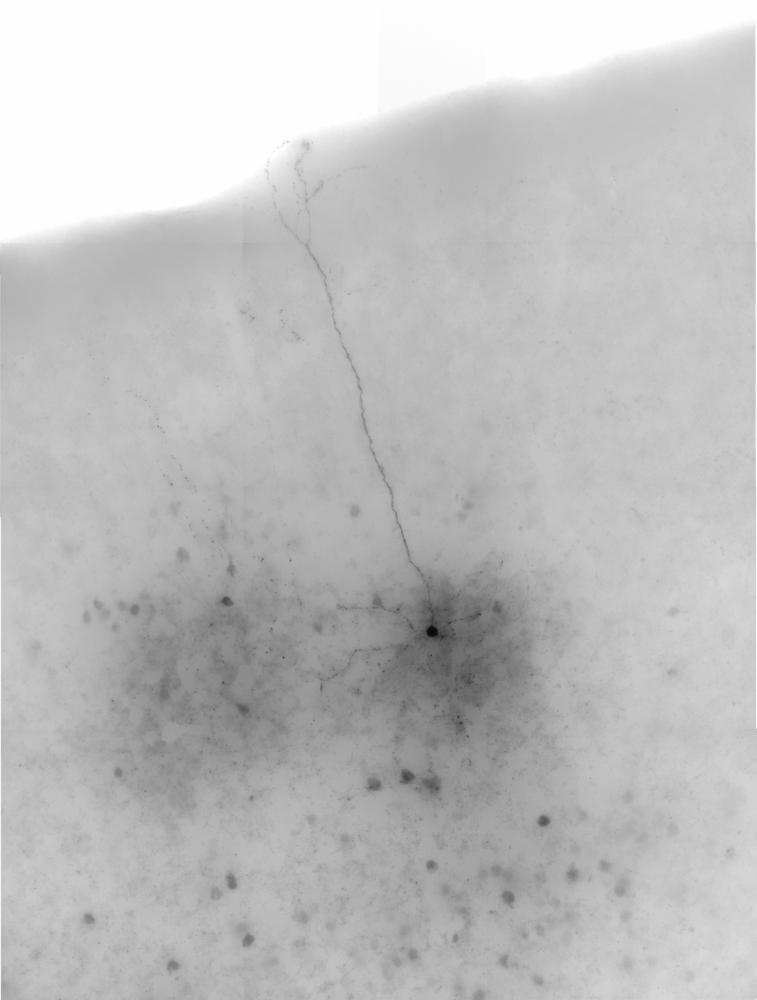

In [15]:
# TODO: want this scale_factor gone. 
# Find max size file allowed in pre-run cache,
# gen file of that size for later kernel-less viewing will work.
scale_factor = 0.17 #@param {type:"slider", min:0.05, max:1, step:0.01}

# TODO: add in colormap
# color_map = "turbo" #@param ["gray", "inverted", "turbo", "cubehelix", "viridis"]

def set_z_index(Z):
    #print(z)
    #plt.imshow(throtle_scale(image_stack[Z]))
   pass # return Z
#print("Z-index")
#ipywidgets.interact(set_z_index, Z=(0, 500))
pass

x, y = minip_img.size
print(f'({x}, {y})')

x2, y2 = math.floor(x*scale_factor), math.floor(y*scale_factor)
smaller_img = minip_img.resize((x2,y2),PIL.Image.ANTIALIAS)
display(smaller_img)

#print("Downloading to browser one %s image file" % sizeof_fmt(os.path.getsize(mid_depth_filename)))

# TODO: re-enable
#display_image(image_to_show, scale_factor)


In [0]:
# This fullscreens well:
# from IPython.display import Image 
# pil_img = Image(filename='/content/minip.jpeg')
# display(pil_img)

### Download SWC

For a given `cell_id` fetch the `*.swc` file.

#### Via Allen SDK

The RMA method works but the Allen SDK method is more convenient in this case (as it's supposed to be).


In [17]:
print(f'cell_id = {cell_id}')

cell_id = 485909730


In [0]:
def cache_swc_in_fs(a_cell_id, a_file_name):
  """This might raised Exception("Specimen %d has no reconstruction"...) """
  result = False
  try:
    morphology = ctc.get_reconstruction(a_cell_id) 
    print(f'len compartment_list = {len(morphology.compartment_list)}')
    morphology.save(a_file_name)
    result = True
  except Exception as expt:
    print('Exception:' + str(expt)) 
  return result

In [40]:
swc_file_name = f'/content/{cell_id}.swc'

if cache_swc_in_fs(cell_id, swc_file_name):
  print(f'SWC downloaded to {swc_file_name}')
else:
  print(f'No SWC available for cell_id = {cell_id}')

len compartment_list = 1925
SWC downloaded to /content/485909730.swc


In [24]:
!head {swc_file_name}

head: cannot open '/content/485909730.swc' for reading: No such file or directory


Note how the first data row above has parent == -1. That is why the soma is often rendered as a ping pong ball or circle: there is no second end point to draw a tube to because -1 means the root of the tree of segments.

#### Bounding box

Below, the skeleton's bounding box can be used to crop plate images (raw or projections) to the region of interest. The format for the cropbox is how much to crop from each side: ((top, bottom), (left, right).

This is also useful for checking that the coordinates of the SWC coorespond to the coordinates of the MinIP image, which sometimes is not the case (symmetrical but not to the same scale so difficult to map on to each other).


In [41]:
segments = pd.read_csv(swc_file_name, sep=" ", names=["id", "type", "x", "y", "z", "r", "pid"], skiprows=[0], index_col=0)
segments.dtypes
maxs = segments.max(axis=0)
mins = segments.min(axis=0)

crop_top = mins["y"]
crop_right = maxs["x"]
crop_bottom = maxs["y"]
crop_left = mins["x"]

skeletons_crop_box = ((crop_top, crop_bottom), (crop_left, crop_right))
print(skeletons_crop_box)

print(f'Number of segments: {len(segments.index)}')

((122.6322, 663.6241), (202.5063, 472.4903))
Number of segments: 1925


In [42]:
!ls -lh

total 2.2M
-rw-r--r-- 1 root root 2.1M Apr 16 14:34 485909730_minip.jpeg
-rw-r--r-- 1 root root  83K Apr 16 14:54 485909730.swc
drwxr-xr-x 3 root root 4.0K Apr 16 14:53 cell_types
-rw-r--r-- 1 root root 2.4K Apr 16 14:34 response.json
drwxr-xr-x 1 root root 4.0K Apr  3 16:24 sample_data


## Render skeleton projection

Take textual `*.swc` file and translate it to a 2D image as seen from same perspective as MinIP. The image is a mask, each pixel gets one bit of data, i.e. it is a binary mask which will be used to train an image instance segmentation ML model.
- `1` means the corresponding MinIP pixel is inside the cell.
- `0` means the pixe is not in the cell; it is bright field.



### Align coordinates

As can be seen from the above bound box, the unit of spatial distance in the SWC is not the same as that of the MinIP, where distance is measured in units of pixels. Naively overlaying their images will be symmetrical but not the same size, not even close. They do both agree on the origins (0,0) and (0,0,0) being aligned so it just scaing without bias: just units are changed.

The SWC unit of distance is metric: microns as in real-world 3D-space Euclidian distance. While for the MinIP, distance is just pixels. So, seemingly after tracing skeletons on pixels, the pixel distance is translated to microns before publication of a SWC file.
 
What is the scale factor to map between the two? [Cell Types Morphology Overview](http://help.brain-map.org/download/attachments/8323525/CellTypes_Morph_Overview.pdf?version=4&modificationDate=1528310097913&api=v2):
>Individual cells were imaged at higher resolution for the purpose of automated and manual reconstruction.
Series of 2D images of single neurons were captured with a 63X objective lens (Zeiss Plan APOCHROMAT
63X/1.4 oil, 39.69x total magnification, and an n oil-immersion condenser 1.4 NA), using the Tile & Position and Z-stack ZEN 2012 SP2 software modules (Zeiss). The composite 2D tiled images with X-Y effective pixel size
of 0.114 micron x 0.114 micron were acquired at an interval of 0.28 µm along the Z-axis. 

So, a pixel distance divided by 0.114 equals microns distance.
```
microns_per_pixel = 0.114
```

Actually, we are starting from microns and mapping to pixels so skeleton distance divided by 0.114.

In [0]:
def project_to_2d_polygon(s1, s2):
  """ SWC is a tree of spheres. This takes in two directly
  connected spheres and draws the tube connecting their cross-sectional
  diameter circles (a cylinder with ends of different radii). That
  is projected to 2D, without parallaxis or such; rather simply
  ingore the Z axis and colapse 3D to 2D. That reduces to some 4
  vertex polygon. The return data structure is suitable for input to
  Datashader for plotting."""  
  delta_x = s1['x'] - s2['x']
  if delta_x == 0:
    delta_x = 0.00000001

  delta_y = s1['y'] - s2['y']
  if delta_y == 0:
    delta_y = 0.00000001

  angle = math.atan(delta_x/delta_y)

  v0 = ((s1['x'] + (math.cos(angle) * s1['radius'])), s1['y'] - (math.sin(angle) * s1['radius']) )
  v1 = ((s1['x'] - (math.cos(angle) * s1['radius'])), s1['y'] + (math.sin(angle) * s1['radius']) )
  v2 = ((s2['x'] + (math.cos(angle) * s2['radius'])), s2['y'] - (math.sin(angle) * s2['radius']) )
  v3 = ((s2['x'] - (math.cos(angle) * s2['radius'])), s2['y'] + (math.sin(angle) * s2['radius']) )

  def scale(coords, factor):
    return (coords[0]/factor, coords[1]/factor)

  # Map SWC distances scaled to pixels      
  microns_per_pixel = 0.114
  v0 = scale(v0, microns_per_pixel)
  v1 = scale(v1, microns_per_pixel)
  v2 = scale(v2, microns_per_pixel)
  v3 = scale(v3, microns_per_pixel)

  one_walk = shapely.geometry.Polygon([v0, v1, v3, v2])
  other_walk = shapely.geometry.Polygon([v0, v2, v3, v1])

  # Datashader wants vertices listed clockwise not ccw (couter clock wise)
  if one_walk.exterior.is_ccw:
    return [v0[0],v0[1],v1[0],v1[1],v3[0],v3[1],v2[0],v2[1],v0[0],v0[1]]
  else:
    return [v0[0],v0[1],v2[0],v2[1],v3[0],v3[1],v1[0],v1[1],v0[0],v0[1]]

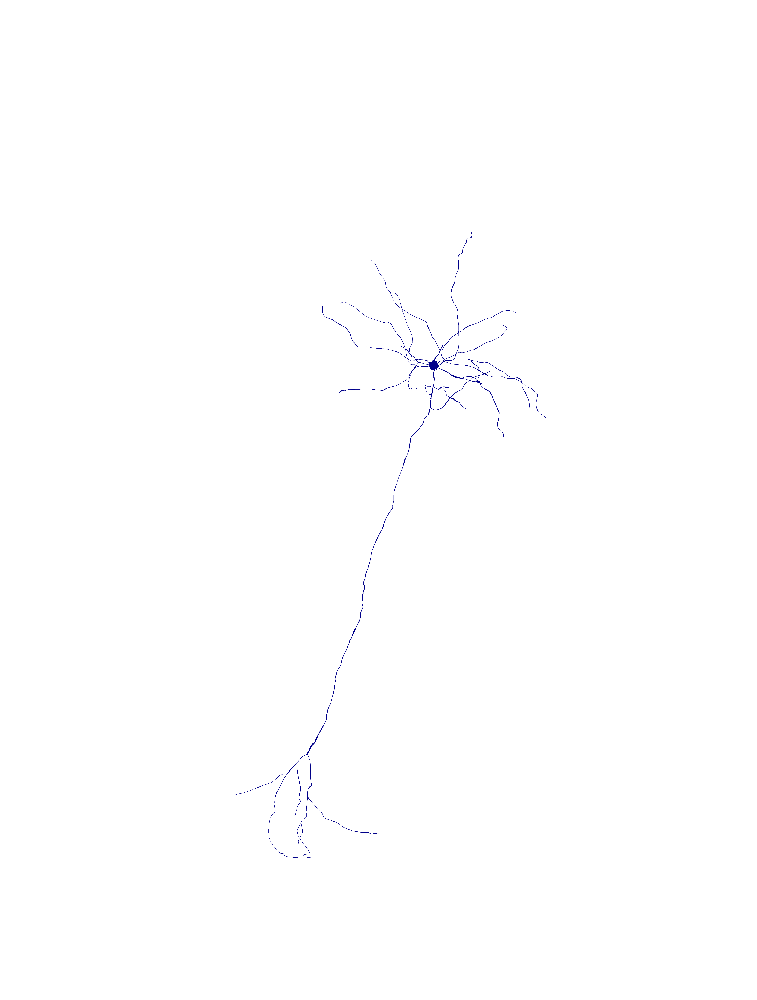

In [50]:
projections = []
morphology = ctc.get_reconstruction(cell_id) 

#head_compartments = itertools.islice(morphology.compartment_list, 30)
#for n in head_compartments:
for n in morphology.compartment_list:
  for c in morphology.children_of(n):
    #if c["type"] == 2:
    #  skeleton_color = "red"
    #else:
    #  skeleton_color = "blue"
    compartment_projection = project_to_2d_polygon(n, c)
    projections.append(compartment_projection)

polygons = PolygonArray([projections])
df = GeoDataFrame({'polygons': polygons, 'v': range(len(polygons))})

minip_width, minip_height = minip_img.size
cvs = ds.Canvas(plot_width=minip_width, plot_height=minip_height, x_range=(0,minip_width), y_range=(0,minip_height), x_axis_type='linear', y_axis_type='linear')

agg = cvs.polygons(df, geometry='polygons', agg=ds.sum('v'))
the_image = tf.shade(agg)
datashader.utils.export_image(the_image, filename='/content/swc_projected', fmt=".png")


In [52]:
!ls -lh

total 2.4M
-rw-r--r-- 1 root root 2.1M Apr 16 14:34 485909730_minip.jpeg
-rw-r--r-- 1 root root  83K Apr 16 14:54 485909730.swc
drwxr-xr-x 3 root root 4.0K Apr 16 14:53 cell_types
-rw-r--r-- 1 root root 2.4K Apr 16 14:34 response.json
drwxr-xr-x 1 root root 4.0K Apr  3 16:24 sample_data
-rw-r--r-- 1 root root 217K Apr 16 15:08 swc_projected.png


(5744, 7583)


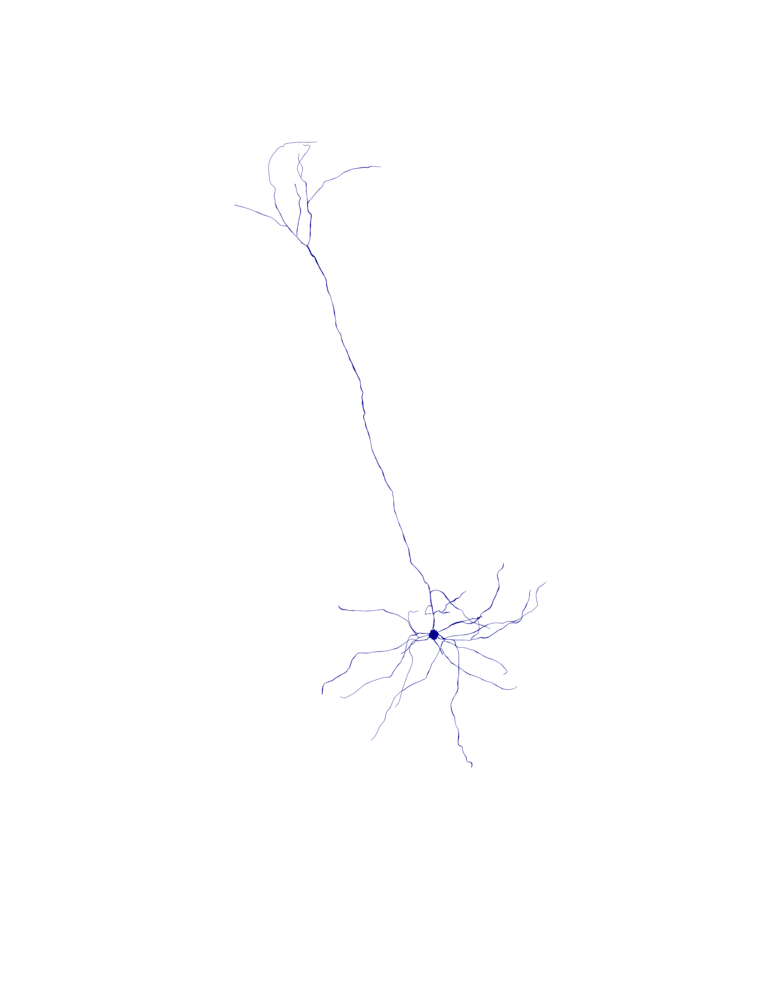

In [10]:
import PIL.ImageOps

swc_projected_img = PIL.Image.open('/content/swc_projected.png')
swc_projected_img = PIL.ImageOps.flip(swc_projected_img)

#x, y = saved_img.size
#print(f'({x}, {y})')

x_swc, y_swc = swc_projected_img.size
print(f'({x_swc}, {y_swc})')

x2, y2 = math.floor(x_swc*1.0), math.floor(y_swc*1.0)
smaller_swc_img = swc_projected_img.resize((x2,y2),PIL.Image.ANTIALIAS)
#display(smaller_swc_img)
display(smaller_swc_img)


## Juxtapose both projections

Now we have two images of the same dimension.


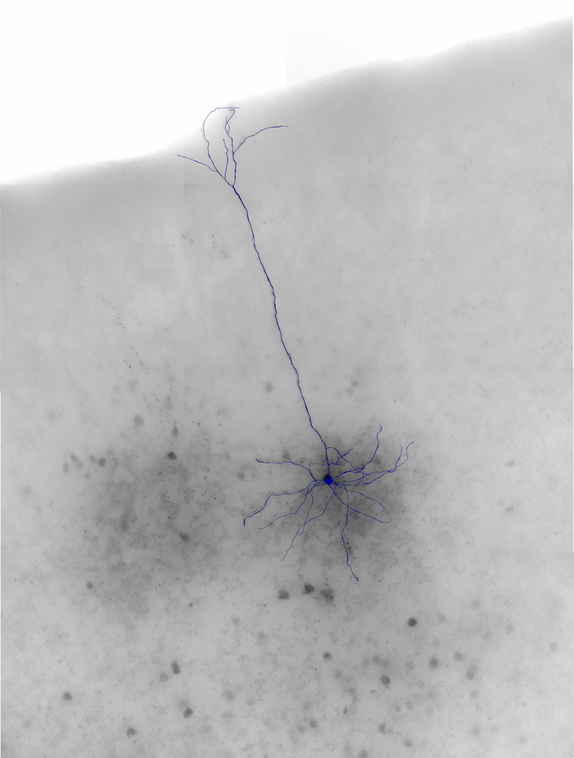

In [11]:
# Via https://stackoverflow.com/a/38629258

# Blank, same size, ready for pasting with masked transparency
merged_img = PIL.Image.new('RGBA', (swc_projected_img.size[0], swc_projected_img.size[1]), (0, 0, 0, 0))
merged_img.paste(minip_img, (0,0))
merged_img.paste(swc_projected_img, (0,0), mask=swc_projected_img)

x2, y2 = math.floor(x_swc*0.5), math.floor(y_swc*0.5)
smaller_merged_img = merged_img.resize((x2,y2),PIL.Image.ANTIALIAS)

display(smaller_merged_img)

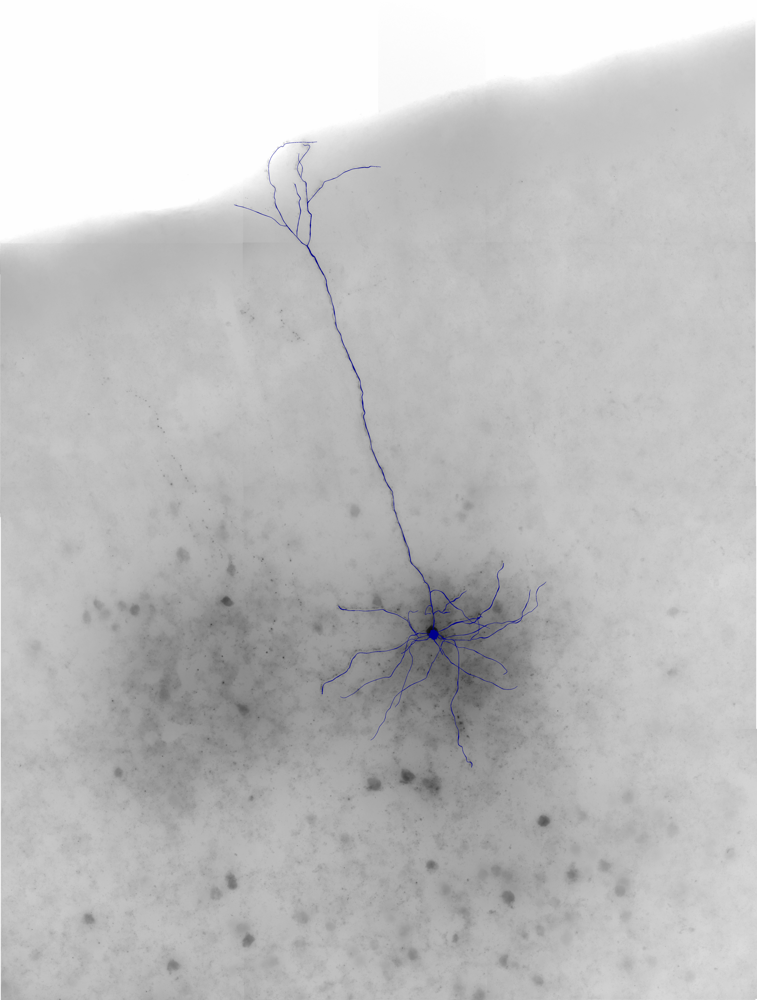

In [12]:
display(merged_img)

## Appendices

### Future work

Later, the workflow defined here will need to be extended from 2D to 3D. Both need a segmentation mask generated from the SWC, the former of pixels the latter of voxels. See [Issue #191](https://github.com/reconstrue/brightfield/issues/191).



### Legal

<img src="http://reconstrue.com/assets/images/reconstrue_combo_mark.svg" width="233px" />

This code is [licensed by Reconstrue under the Apache 2.0 License](https://github.com/reconstrue/brightfield_neuron_reconstruction_on_colab/blob/master/LICENSE).


In [0]:
# Copyright 2019-2020 Reconstrue Inc. All Rights Reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
# ==============================================================================

### References
Allen Cell Types Database docs
- [Technical White Paper: Cell Morphology and Histology](http://help.brain-map.org/download/attachments/8323525/CellTypes_Morph_Overview.pdf?version=4&modificationDate=1528310097913&api=v2)
- [Cell Types API](http://help.brain-map.org/display/celltypes/API)
- [ImageDownloadApi.download_image()](http://alleninstitute.github.io/AllenSDK/allensdk.api.queries.image_download_api.html#allensdk.api.queries.image_download_api.ImageDownloadApi)
- [RESTful Model Access (RMA)](http://help.brain-map.org/pages/viewpage.action?pageId=5308449)
